This tutorial processes C. elegans embryogenesis single cell data published by [Packer & Zhu et al., 2019](https://doi.org/10.1126/science.aax1971). Data can be downloaded from https://zenodo.org/records/15236812.

### Load package and data

In [ ]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/celegans_data/') # Replace with your data directory
data_path = data_dir / "celegans_global_adata.h5ad"
adata = sc.read(data_path)

In [2]:
proj_name = "concord_celegans"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [15]:
adata.layers["counts"] = adata.X.copy() # Store raw counts in a layer, because adata.X can be modified
adata = adata[adata.obs['to.filter'] == 'FALSE'] # Only keep cells that pass quality filter

### Run Concord

In [ ]:
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 300, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.3, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.3, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.3, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'p_intra_domain': .95, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 15, # Number of epochs for training, adjust as needed
        'domain_key': 'batch', # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'inplace': False, # Whether to modify adata in place, if not you need to copy the obsm out of ccd.adata
        'seed': seed, # random seed for reproducibility
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

In [ ]:
output_key = 'Concord'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.encode_adata(input_layer_key='X_log1p', output_key=output_key) # Result saved to ccd.adata.obsm[output_key]
adata.obsm = cur_ccd.adata.obsm # If not inplace, copy the obsm out of ccd.adata

Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 10000
Concord - INFO - Model loaded to device: mps
Concord - INFO - Total number of parameters: 10303956


FAISS not found. Using sklearn for k-NN computation.


p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/15
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 89701


Epoch 0 Training: 1399it [00:37, 37.06it/s, loss=2.45]

Concord - INFO - Epoch   0 | Train Loss: 2.67, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.67, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/15
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 1 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.43it/s, loss=2.52]

Concord - INFO - Epoch   1 | Train Loss: 2.48, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.48, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/15
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 2 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.35it/s, loss=2.51]

Concord - INFO - Epoch   2 | Train Loss: 2.44, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.44, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/15
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 3 Training: 100%|██████████| 1399/1399 [00:34<00:00, 41.01it/s, loss=2.3] 

Concord - INFO - Epoch   3 | Train Loss: 2.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.40, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/15
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 4 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.41it/s, loss=2.39]

Concord - INFO - Epoch   4 | Train Loss: 2.39, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.39, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/15
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 5 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.57it/s, loss=2.29]

Concord - INFO - Epoch   5 | Train Loss: 2.37, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.37, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/15
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 6 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.50it/s, loss=2.31]

Concord - INFO - Epoch   6 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/15
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 7 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.51it/s, loss=2.21]

Concord - INFO - Epoch   7 | Train Loss: 2.35, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.35, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/15
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 8 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.50it/s, loss=2.3] 

Concord - INFO - Epoch   8 | Train Loss: 2.34, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.34, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 10/15
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 89701


Epoch 9 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.59it/s, loss=2.42]

Concord - INFO - Epoch   9 | Train Loss: 2.33, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.33, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 11/15
Concord - INFO - Processing chunk 1/1 for epoch 11
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 10 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.54it/s, loss=2.33]

Concord - INFO - Epoch  10 | Train Loss: 2.33, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.33, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 12/15
Concord - INFO - Processing chunk 1/1 for epoch 12
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 11 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.32it/s, loss=2.28]

Concord - INFO - Epoch  11 | Train Loss: 2.32, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.32, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 13/15
Concord - INFO - Processing chunk 1/1 for epoch 13
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 12 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.49it/s, loss=2.32]

Concord - INFO - Epoch  12 | Train Loss: 2.32, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.32, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 14/15
Concord - INFO - Processing chunk 1/1 for epoch 14
Concord - INFO - Number of samples in train_dataloader: 89701


Epoch 13 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.79it/s, loss=2.34]

Concord - INFO - Epoch  13 | Train Loss: 2.31, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.31, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 15/15
Concord - INFO - Processing chunk 1/1 for epoch 15
Concord - INFO - Number of samples in train_dataloader: 89701



Epoch 14 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.68it/s, loss=2.28]

Concord - INFO - Epoch  14 | Train Loss: 2.31, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.31, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/concord_celegans-Apr17/final_model_Apr17-1444.pt
Concord - INFO - Final model saved at: ../save/concord_celegans-Apr17/final_model_Apr17-1444.pt; Configuration saved at: ../save/concord_celegans-Apr17/config_Apr17-1444.json.
Concord - INFO - Predicting for chunk 1/1


### Visualization

We recommend using UMAP to visualize the CONCORD latent space:

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


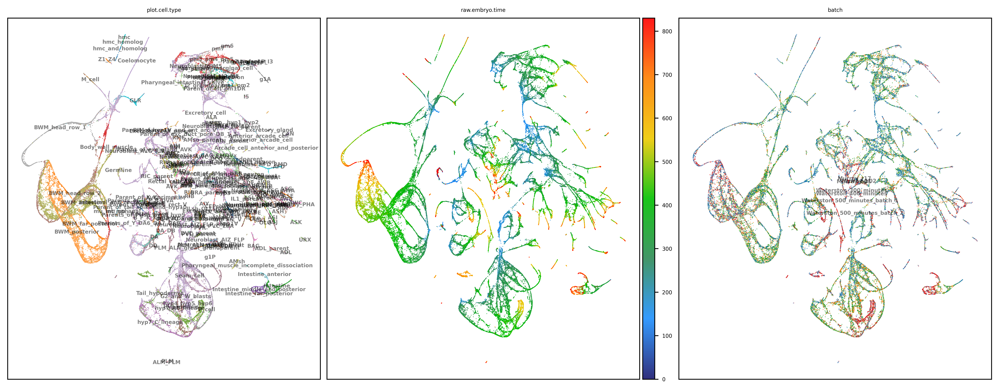

In [ ]:
basis = 'Concord'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['plot.cell.type', 'raw.embryo.time', "batch"]
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = pal,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [ ]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal[col],
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000
        )

In [37]:
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad") # Save the adata object with the encoded embeddings
print(f"Saved adata to {data_dir / f'{proj_name}_{file_suffix}.h5ad'}")

Saved adata to ../data/celegans_data/concord_celegans_Apr17-1140.h5ad
